In [68]:
import torch
import torch.nn as nn
from torchvision import transforms
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
import matplotlib.pyplot as plt
from torch.nn import functional as F
import numpy as np
from PIL import Image
from skimage import color
import os
from torchsummary import summary
from tqdm import tqdm

In [4]:
device = ('cuda' if torch.cuda.is_available() else 'cpu')

In [ ]:
!nvidia-smi

Sun Apr 28 13:48:27 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.129.03             Driver Version: 535.129.03   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla P100-PCIE-16GB           Off | 00000000:00:04.0 Off |                    0 |
| N/A   35C    P0              27W / 250W |      2MiB / 16384MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [5]:
print('Обучение будет проходить на {}'.format(device))

Обучение будет проходить на cuda


In [6]:
image_count = 10
images = os.listdir("dataset/train")
indices = np.random.choice(np.arange(len(images)), image_count)

In [7]:
def visualization_dataset(indices):
    plt.figure(figsize=(16, 6))
    rows = 2
    cols = 5

    for i, index in enumerate(indices):
        plt.subplot(rows, cols, i+1)
        image = Image.open(os.path.join("dataset/train", images[index]))
        plt.imshow(image)
        plt.axis("off")

    plt.show()

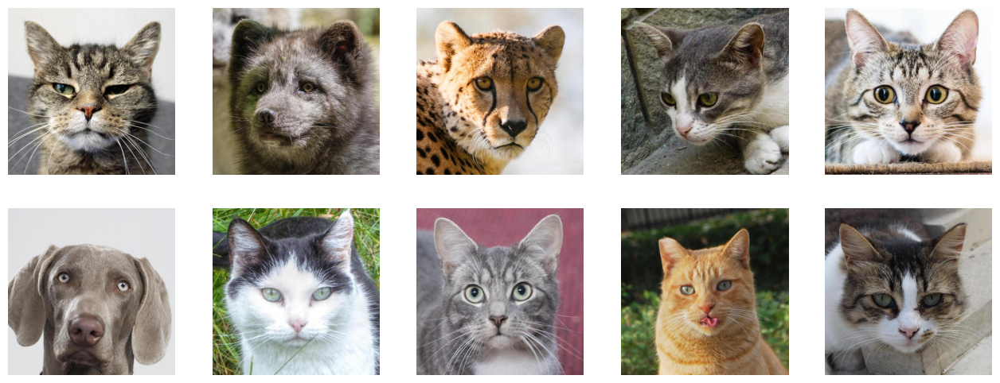

In [ ]:
visualization_dataset(indices)

# Определение сети pix2pix

In [69]:
class CustomDataset(Dataset):
    def __init__(self, root_dir, mode):
        self.root_dir = root_dir
        self.data = os.listdir(self.root_dir)
        self.mode = mode

        # Преобразования описаны в статье по pix2pix
        if mode == "train":
            self.transform = transforms.Compose([
                transforms.Resize((256, 256), Image.BICUBIC),
                transforms.RandomHorizontalFlip(0.5)
            ])
        else:
            self.transform = transforms.Compose([
                transforms.Resize((256, 256), Image.BICUBIC)
            ])

    def __len__(self):
        return len(self.data)

    def __getitem__(self, index):
        image_name = os.path.join(self.root_dir, self.data[index])
        color_image = Image.open(image_name).convert("RGB")
        color_image = self.transform(color_image)
        color_image_numpy = np.array(color_image)
        img_lab = color.rgb2lab(color_image_numpy).astype("float32")
        img_lab = transforms.ToTensor()(img_lab)
        l_channel = img_lab[[0], ...] / 50. - 1.
        ab_channels = img_lab[[1, 2], ...] / 110.

        return {"L": l_channel, "ab" : ab_channels}

In [70]:
train_dataset = CustomDataset('dataset/train', mode = "train")
val_dataset = CustomDataset('dataset/validation', mode = "val")

In [71]:
class DownBlock(nn.Module):
    def __init__(self, input_channels, output_channels, use_batch_norm=True):
        super(DownBlock, self).__init__()
        self.conv_layer = nn.Conv2d(input_channels, output_channels, kernel_size=4, stride=2, padding=1, bias=False)
        self.batch_norm = nn.BatchNorm2d(output_channels) if use_batch_norm else None
        self.conv2d = nn.Conv2d(output_channels, output_channels, kernel_size=3, padding=1)
        nn.init.normal_(self.conv_layer.weight, mean=0.0, std=0.02)
        nn.init.normal_(self.conv2d.weight, mean=0.0, std=0.02)

    def forward(self, x):
        x = self.conv_layer(x)
        if self.batch_norm:
            x = self.batch_norm(x)
        x = F.leaky_relu(x, 0.2)
        x = F.leaky_relu(self.conv2d(x), 0.2)
        return x

class UpBlock(nn.Module):
    def __init__(self, input_channels, output_channels, dropout=False):
        super(UpBlock, self).__init__()
        self.up_conv = nn.ConvTranspose2d(input_channels, output_channels, kernel_size=4, stride=2, padding=1, bias=False)
        self.batch_norm = nn.BatchNorm2d(output_channels)
        self.conv2d = nn.Conv2d(output_channels, output_channels, kernel_size=3, padding=1)
        self.dropout = nn.Dropout2d(0.5) if dropout else None
        nn.init.normal_(self.up_conv.weight, mean=0.0, std=0.02)
        nn.init.normal_(self.conv2d.weight, mean=0.0, std=0.02)

    def forward(self, x):
        x = self.batch_norm(self.up_conv(x))
        if self.dropout:
            x = self.dropout(x)
        x = F.relu(x)
        x = F.relu(self.conv2d(x))
        return x

class GeneratorNet(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(GeneratorNet, self).__init__()
        self.down_1 = DownBlock(in_channels, 64, use_batch_norm=False)
        self.down_2 = DownBlock(64, 128)
        self.down_3 = DownBlock(128, 256)
        self.down_4 = DownBlock(256, 512)
        self.down_5 = DownBlock(512, 512)
        self.down_6 = DownBlock(512, 512)
        self.down_7 = DownBlock(512, 512)
        self.down_8 = DownBlock(512, 512, use_batch_norm=False)

        self.up_1 = UpBlock(512, 512, dropout=True)
        self.up_2 = UpBlock(1024, 512, dropout=True)
        self.up_3 = UpBlock(1024, 512, dropout=True)
        self.up_4 = UpBlock(1024, 512, dropout=False)
        self.up_5 = UpBlock(1024, 256, dropout=False)
        self.up_6 = UpBlock(512, 128, dropout=False)
        self.up_7 = UpBlock(256, 64, dropout=False)

        self.output_layer = nn.ConvTranspose2d(128, out_channels, kernel_size=4, stride=2, padding=1)
        nn.init.normal_(self.output_layer.weight, mean=0.0, std=0.02)

    def forward(self, x):
        d1 = self.down_1(x)
        d2 = self.down_2(d1)
        d3 = self.down_3(d2)
        d4 = self.down_4(d3)
        d5 = self.down_5(d4)
        d6 = self.down_6(d5)
        d7 = self.down_7(d6)
        d8 = self.down_8(d7)

        u1 = self.up_1(d8)
        u2 = self.up_2(torch.cat([u1, d7], dim=1))
        u3 = self.up_3(torch.cat([u2, d6], dim=1))
        u4 = self.up_4(torch.cat([u3, d5], dim=1))
        u5 = self.up_5(torch.cat([u4, d4], dim=1))
        u6 = self.up_6(torch.cat([u5, d3], dim=1))
        u7 = self.up_7(torch.cat([u6, d2], dim=1))

        output = F.tanh(self.output_layer(torch.cat([u7, d1], dim=1)))
        return output

class PatchDiscriminator(nn.Module):
    def __init__(self, input_channels):
        super(PatchDiscriminator, self).__init__()
        self.conv_1 = DownBlock(3, 64, use_batch_norm=False)
        self.conv_2 = DownBlock(64, 128)
        self.conv_3 = DownBlock(128, 256)
        self.conv_4 = DownBlock(256, 512)
        self.zero_pad = nn.ZeroPad2d((1, 0, 1, 0))
        self.final_layer = nn.Conv2d(512, 1, kernel_size=4, padding=1)

    def forward(self, x):
        x = self.conv_1(x)
        x = self.conv_2(x)
        x = self.conv_3(x)
        x = self.conv_4(x)
        x = self.zero_pad(x)
        x = self.final_layer(x)
        return x

In [ ]:
summary(GeneratorNet(1, 2).to(device), input_size=(1, 256, 256), device=device)

----------------------------------------------------------------

        Layer (type)               Output Shape         Param #


            Conv2d-1         [-1, 64, 128, 128]           1,024

            Conv2d-2         [-1, 64, 128, 128]          36,928

         DownBlock-3         [-1, 64, 128, 128]               0

            Conv2d-4          [-1, 128, 64, 64]         131,072

       BatchNorm2d-5          [-1, 128, 64, 64]             256

            Conv2d-6          [-1, 128, 64, 64]         147,584

         DownBlock-7          [-1, 128, 64, 64]               0

            Conv2d-8          [-1, 256, 32, 32]         524,288

       BatchNorm2d-9          [-1, 256, 32, 32]             512

           Conv2d-10          [-1, 256, 32, 32]         590,080

        DownBlock-11          [-1, 256, 32, 32]               0

           Conv2d-12          [-1, 512, 16, 16]       2,097,152

      BatchNorm2d-13          [-1, 512, 16, 16]           1,024

           Conv2d-14   

In [ ]:
summary(PatchDiscriminator(3), input_size=(3, 256, 256) , device="cpu")

----------------------------------------------------------------

        Layer (type)               Output Shape         Param #


            Conv2d-1         [-1, 64, 128, 128]           3,072

            Conv2d-2         [-1, 64, 128, 128]          36,928

         DownBlock-3         [-1, 64, 128, 128]               0

            Conv2d-4          [-1, 128, 64, 64]         131,072

       BatchNorm2d-5          [-1, 128, 64, 64]             256

            Conv2d-6          [-1, 128, 64, 64]         147,584

         DownBlock-7          [-1, 128, 64, 64]               0

            Conv2d-8          [-1, 256, 32, 32]         524,288

       BatchNorm2d-9          [-1, 256, 32, 32]             512

           Conv2d-10          [-1, 256, 32, 32]         590,080

        DownBlock-11          [-1, 256, 32, 32]               0

           Conv2d-12          [-1, 512, 16, 16]       2,097,152

      BatchNorm2d-13          [-1, 512, 16, 16]           1,024

           Conv2d-14   

In [72]:
class GANLoss(nn.Module):
    def __init__(self, real_label=1.0, fake_label=0.0, mode="vanilla", target="real"):
        super(GANLoss, self).__init__()
        self.register_buffer("real_labels", torch.tensor(real_label))
        self.register_buffer("fake_labels", torch.tensor(fake_label))

        if mode == "vanilla":
            self.loss = nn.BCEWithLogitsLoss()
        else:
            self.loss = nn.MSELoss()

    def __call__(self, predictions, target_is_real):
        if target_is_real:
            labels = self.real_labels
        else:
            labels = self.fake_labels
        labels = labels.expand_as(predictions)

        return self.loss(predictions, labels)

In [73]:
class Model(nn.Module):
    def __init__(self, device, lambda_L1=100.):
        super().__init__()

        self.device = device
        self.lambda_L1 = lambda_L1

        self.generator_net = GeneratorNet(1, 2).to(self.device)
        self.discriminator_net = PatchDiscriminator(3).to(self.device)
        self.generator_loss = GANLoss(mode='vanilla').to(self.device)
        self.discriminator_loss = nn.L1Loss()
        self.generator_optimizer = optim.Adam(self.generator_net.parameters(), lr=2e-4, betas=(0.5, 0.999))
        self.discriminator_optimizer = optim.Adam(self.discriminator_net.parameters(), lr=2e-4, betas=(0.5, 0.999))

    def set_requires_grad(self, model, requires_grad=True):
        for p in model.parameters():
            p.requires_grad = requires_grad

    def setup_input(self, data):
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)

    def forward(self):
        self.fake_ab = self.generator_net(self.L)

    def backward_D(self):
        fake_image = torch.cat([self.L, self.fake_ab], dim=1)
        fake_preds = self.discriminator_net(fake_image.detach())
        self.loss_D_fake = self.generator_loss(fake_preds, False)
        real_image = torch.cat([self.L, self.ab], dim=1)
        real_preds = self.discriminator_net(real_image)
        self.loss_D_real = self.generator_loss(real_preds, True)
        self.loss_D = (self.loss_D_fake + self.loss_D_real) * 0.5
        self.loss_D.backward()

    def backward_G(self):
        fake_image = torch.cat([self.L, self.fake_ab], dim=1)
        fake_preds = self.discriminator_net(fake_image)
        self.loss_G_GAN = self.generator_loss(fake_preds, True)
        self.loss_G_L1 = self.discriminator_loss(self.fake_ab, self.ab) * self.lambda_L1
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward()

    def optimize(self):
        self.forward()
        self.discriminator_net.train()
        self.set_requires_grad(self.discriminator_net, True)
        self.discriminator_optimizer.zero_grad()
        self.backward_D()
        self.discriminator_optimizer.step()

        self.generator_net.train()
        self.set_requires_grad(self.discriminator_net, False)
        self.generator_optimizer.zero_grad()
        self.backward_G()
        self.generator_optimizer.step()

In [74]:
def visualize_work_model(model, data):
    model.generator_net.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()

    model.generator_net.train()
    fake_ab = model.fake_ab.detach()
    real_ab = model.ab
    l_channel = model.L

    fake_imgs = lab_to_rgb(l_channel, fake_ab)
    real_imgs = lab_to_rgb(l_channel, real_ab)

    fig, axs = plt.subplots(3, 5, figsize=(15, 9))

    for index in range(5):
        axs[0, index].imshow(l_channel[index][0].cpu().numpy(), cmap="gray")
        axs[0, index].axis("off")

        axs[1, index].imshow(fake_imgs[index])
        axs[1, index].axis("off")

        axs[2, index].imshow(real_imgs[index])
        axs[2, index].axis("off")

    plt.show()

def lab_to_rgb(L, ab):
    rgb_images = []
    L, ab = (L + 1.) * 50. , ab * 110.
    lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    for image in lab:
        image_rgb = color.lab2rgb(image)
        rgb_images.append(image_rgb)

    return np.stack(rgb_images, axis=0)

In [75]:
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True, pin_memory=True)
val_loader = DataLoader(val_dataset, batch_size=16, pin_memory=True)

# Обучение сети

In [76]:
EPOCHS = 120
model = Model(device).to(device)

def training_loop(model, train_loader, num_epochs):
    for epoch in range(num_epochs):
        for data in tqdm(train_loader):
            model.setup_input(data)
            model.optimize()
        if epoch % 10 == 0:
            visualize_work_model(model, data)

        print(f"[{epoch+1}/{num_epochs}]: Complite!")

100%|██████████| 52/52 [00:45<00:00,  1.16it/s]


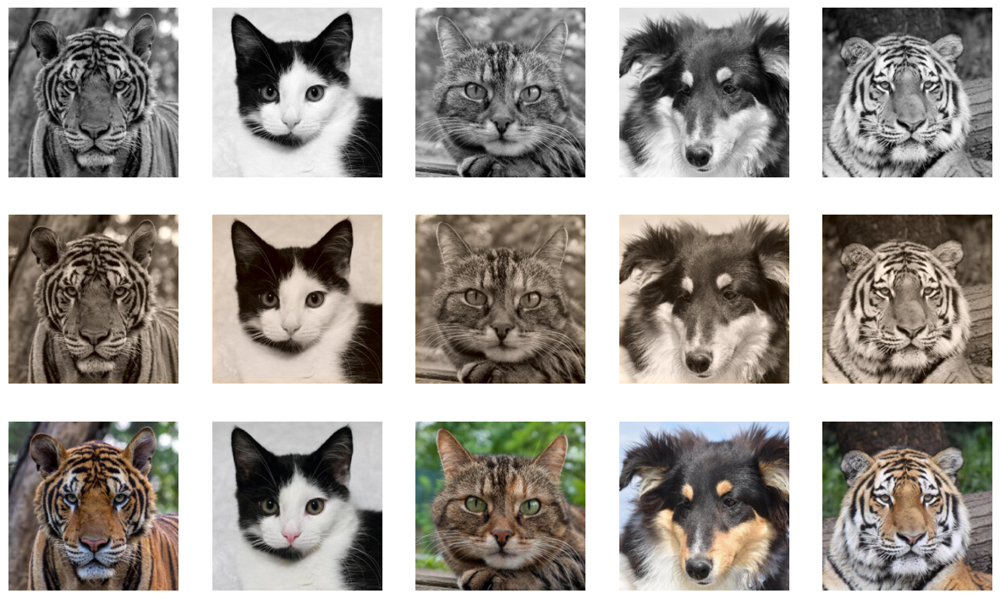

[1/120]: Complite!


100%|██████████| 52/52 [00:28<00:00,  1.80it/s]


[2/120]: Complite!


100%|██████████| 52/52 [00:28<00:00,  1.81it/s]


[3/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.67it/s]


[4/120]: Complite!


100%|██████████| 52/52 [00:29<00:00,  1.77it/s]


[5/120]: Complite!


100%|██████████| 52/52 [00:29<00:00,  1.76it/s]


[6/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.73it/s]


[7/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.72it/s]


[8/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.71it/s]


[9/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.71it/s]


[10/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.72it/s]


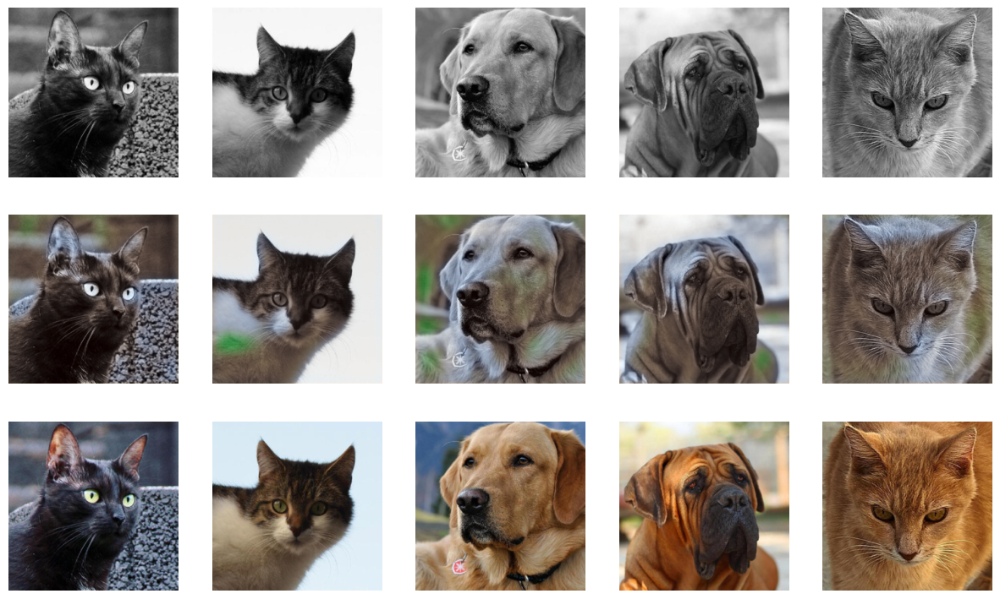

[11/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.71it/s]


[12/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.73it/s]


[13/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.71it/s]


[14/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.70it/s]


[15/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.70it/s]


[16/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.72it/s]


[17/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.72it/s]


[18/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.71it/s]


[19/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.71it/s]


[20/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.70it/s]


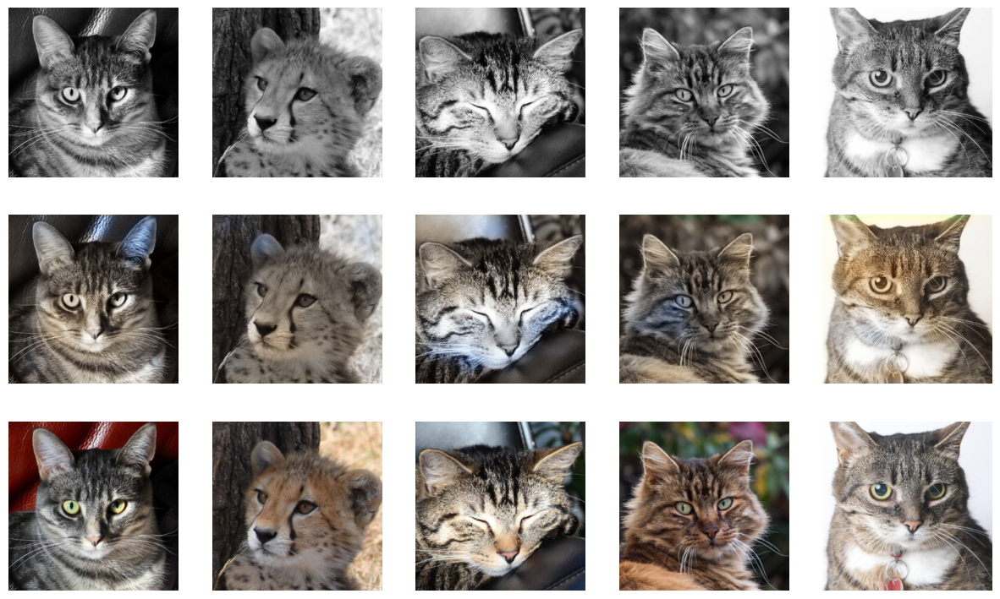

[21/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.68it/s]


[22/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.72it/s]


[23/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.72it/s]


[24/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.72it/s]


[25/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.71it/s]


[26/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.71it/s]


[27/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.69it/s]


[28/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.69it/s]


[29/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.69it/s]


[30/120]: Complite!


100%|██████████| 52/52 [00:33<00:00,  1.54it/s]


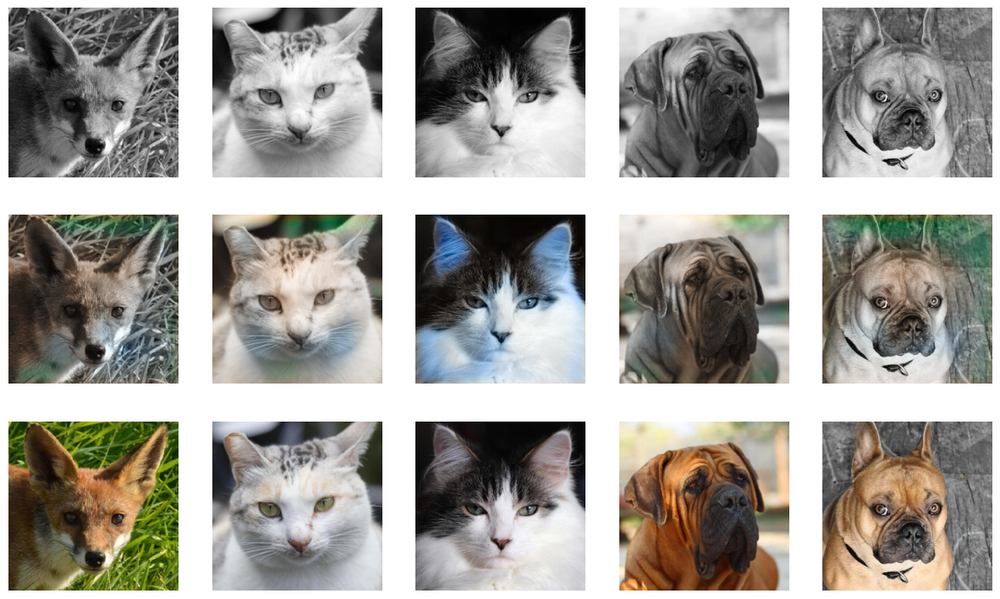

[31/120]: Complite!


100%|██████████| 52/52 [00:35<00:00,  1.47it/s]


[32/120]: Complite!


100%|██████████| 52/52 [00:38<00:00,  1.34it/s]


[33/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.66it/s]


[34/120]: Complite!


100%|██████████| 52/52 [00:32<00:00,  1.59it/s]


[35/120]: Complite!


100%|██████████| 52/52 [00:37<00:00,  1.39it/s]


[36/120]: Complite!


100%|██████████| 52/52 [00:36<00:00,  1.41it/s]


[37/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.72it/s]


[38/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.65it/s]


[39/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.69it/s]


[40/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.68it/s]


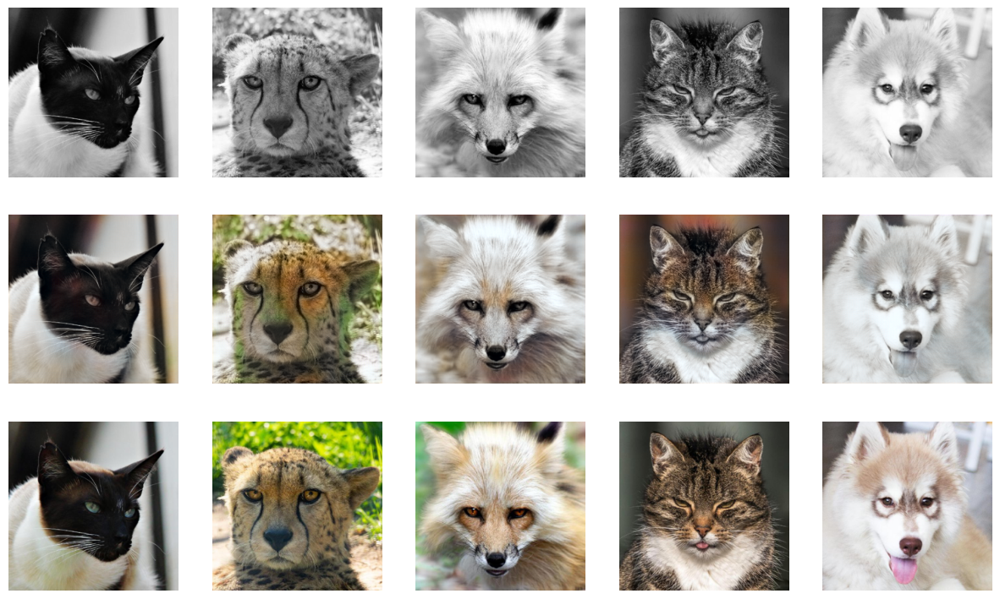

[41/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.64it/s]


[42/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.69it/s]


[43/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.70it/s]


[44/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.64it/s]


[45/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.66it/s]


[46/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.69it/s]


[47/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.69it/s]


[48/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.69it/s]


[49/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.70it/s]


[50/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.67it/s]


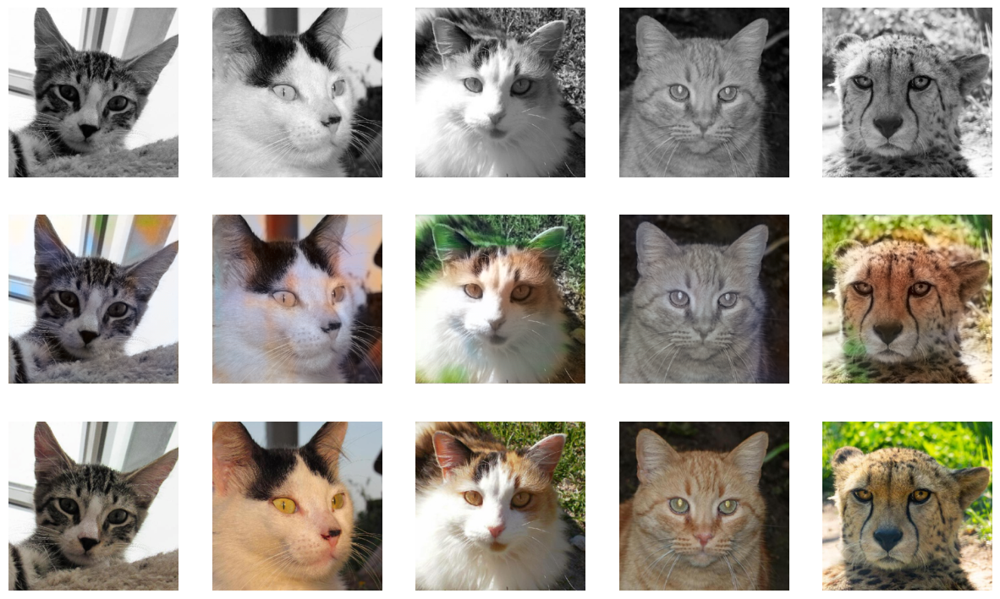

[51/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.67it/s]


[52/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.68it/s]


[53/120]: Complite!


100%|██████████| 52/52 [00:32<00:00,  1.61it/s]


[54/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.68it/s]


[55/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.66it/s]


[56/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.68it/s]


[57/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.66it/s]


[58/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.68it/s]


[59/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.68it/s]


[60/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.68it/s]
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 9 pixels
  return func(*args, **kwargs)
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return func(*args, **kwargs)


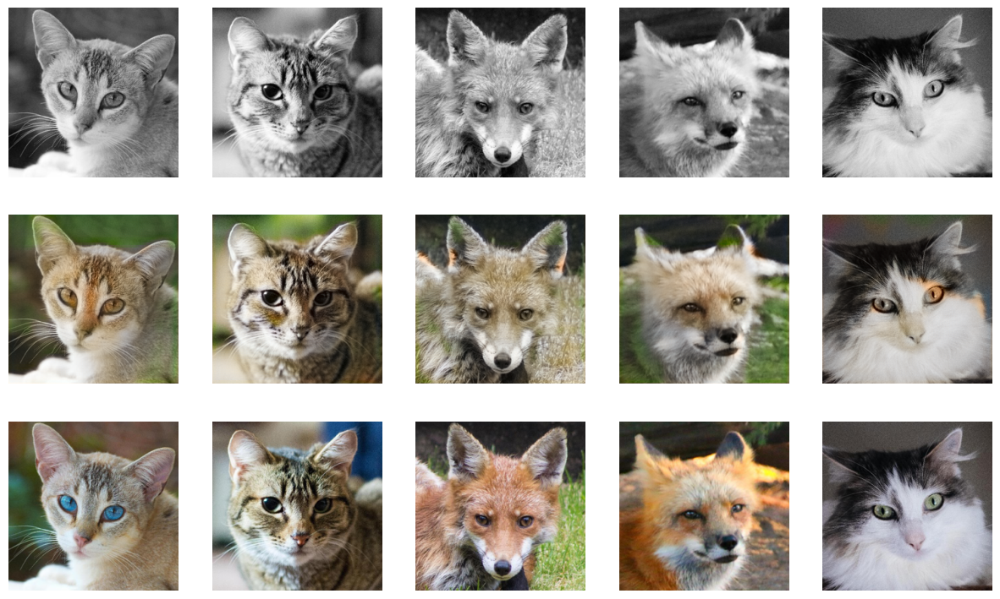

[61/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.68it/s]


[62/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.68it/s]


[63/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.67it/s]


[64/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.69it/s]


[65/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.68it/s]


[66/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.65it/s]


[67/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.66it/s]


[68/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.69it/s]


[69/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.69it/s]


[70/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.68it/s]


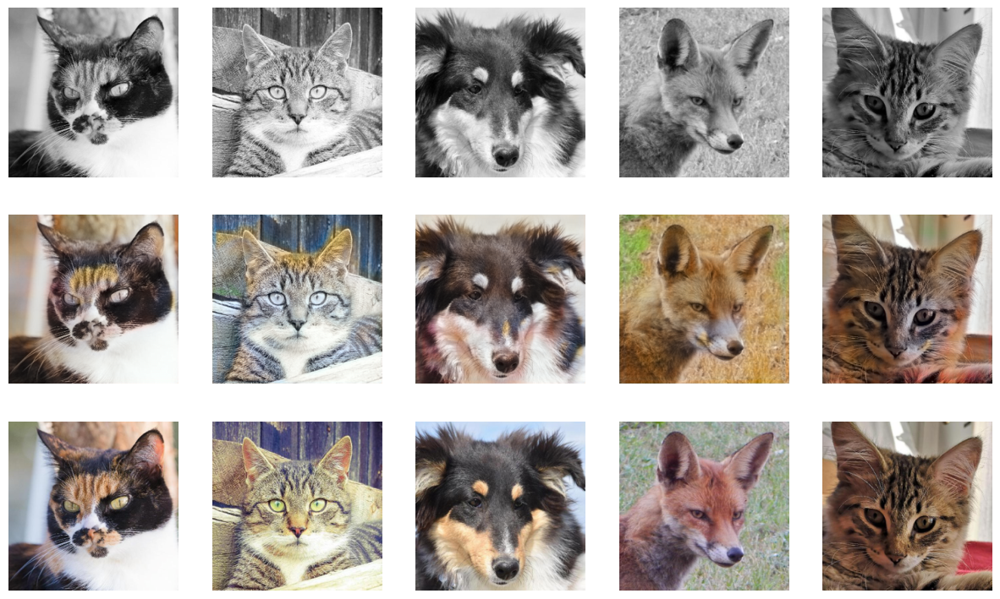

[71/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.66it/s]


[72/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.67it/s]


[73/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.66it/s]


[74/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.69it/s]


[75/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.69it/s]


[76/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.68it/s]


[77/120]: Complite!


100%|██████████| 52/52 [00:30<00:00,  1.68it/s]


[78/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.67it/s]


[79/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.67it/s]


[80/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.64it/s]
/usr/local/lib/python3.10/dist-packages/skimage/_shared/utils.py:394: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return func(*args, **kwargs)


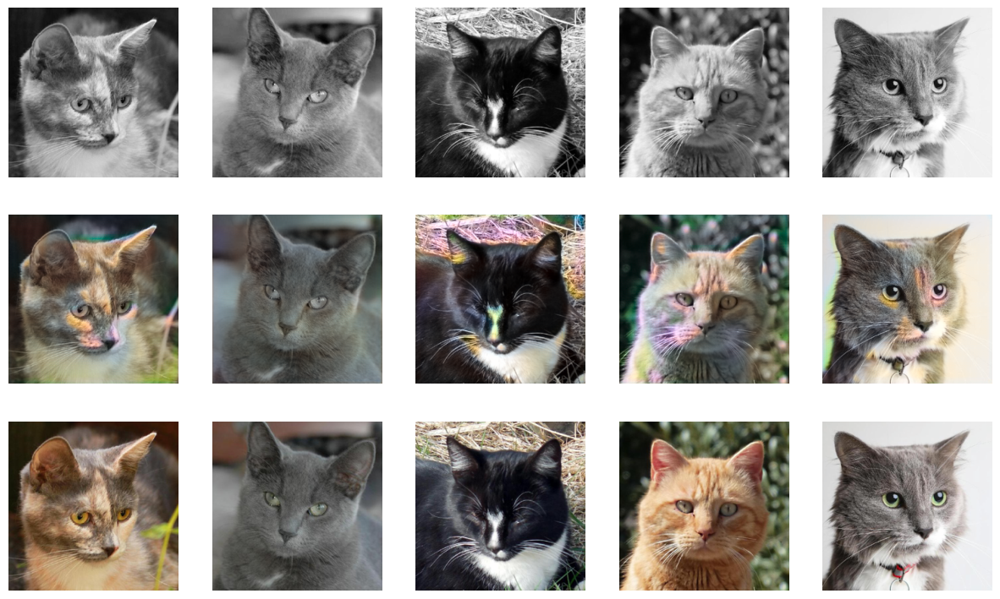

[81/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.65it/s]


[82/120]: Complite!


100%|██████████| 52/52 [00:35<00:00,  1.48it/s]


[83/120]: Complite!


100%|██████████| 52/52 [00:32<00:00,  1.58it/s]


[84/120]: Complite!


100%|██████████| 52/52 [00:34<00:00,  1.50it/s]


[85/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.66it/s]


[86/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.66it/s]


[87/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.64it/s]


[88/120]: Complite!


100%|██████████| 52/52 [00:32<00:00,  1.62it/s]


[89/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.66it/s]


[90/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.64it/s]


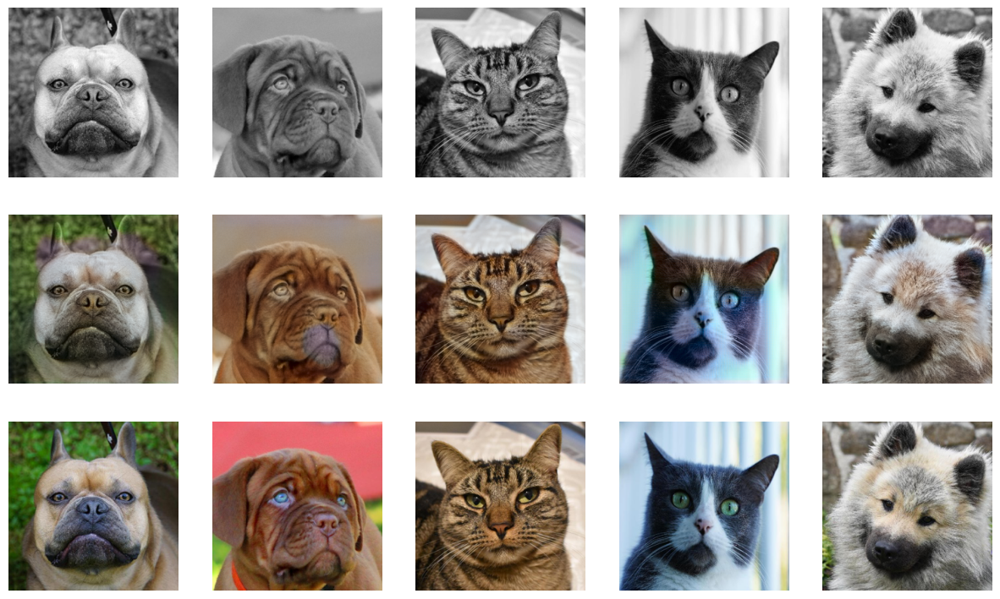

[91/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.66it/s]


[92/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.66it/s]


[93/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.65it/s]


[94/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.66it/s]


[95/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.64it/s]


[96/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.63it/s]


[97/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.64it/s]


[98/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.63it/s]


[99/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.64it/s]


[100/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.66it/s]


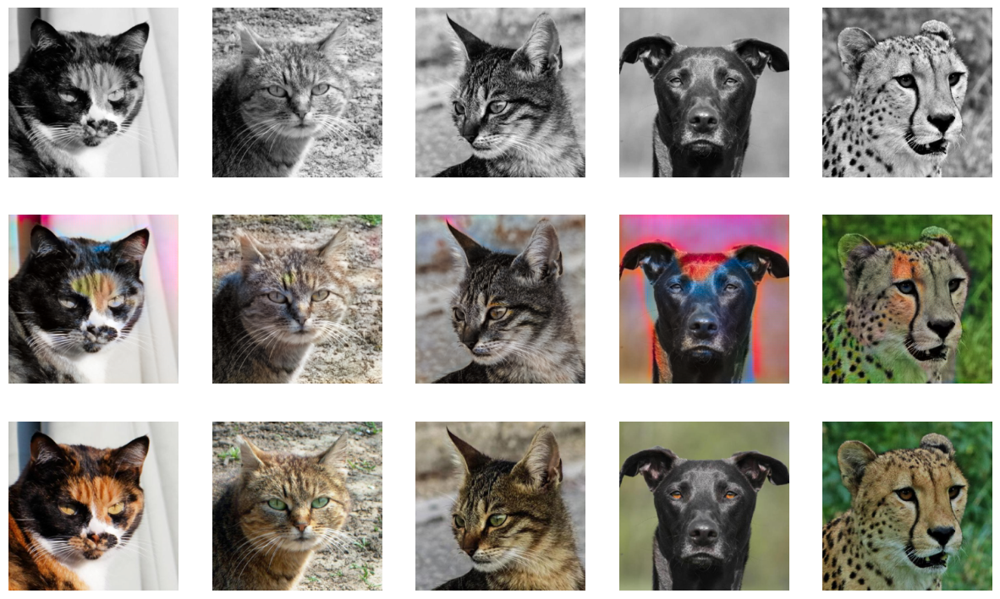

[101/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.65it/s]


[102/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.64it/s]


[103/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.65it/s]


[104/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.66it/s]


[105/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.64it/s]


[106/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.64it/s]


[107/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.66it/s]


[108/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.65it/s]


[109/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.64it/s]


[110/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.65it/s]


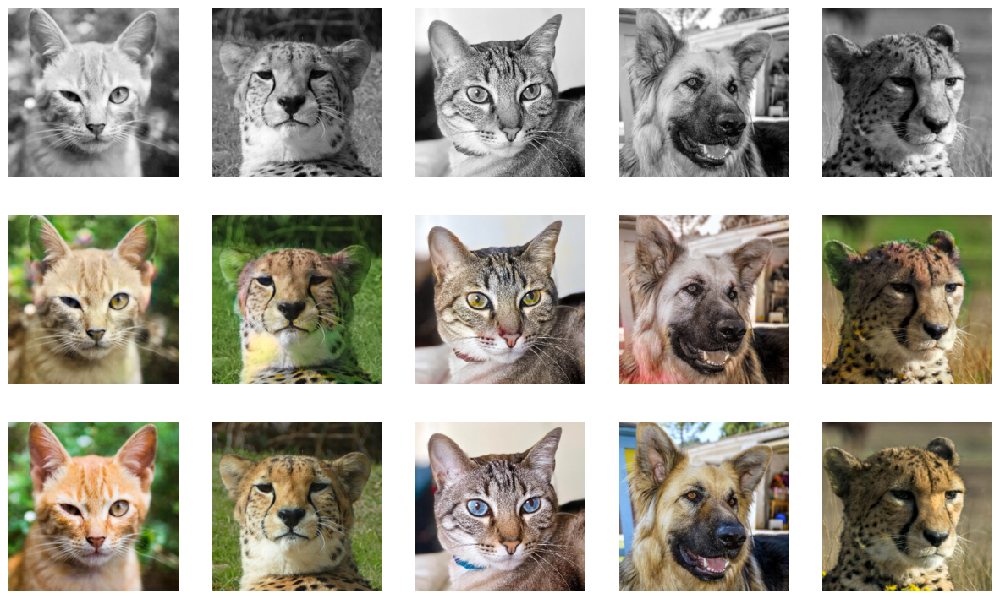

[111/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.65it/s]


[112/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.63it/s]


[113/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.65it/s]


[114/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.65it/s]


[115/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.66it/s]


[116/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.65it/s]


[117/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.65it/s]


[118/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.68it/s]


[119/120]: Complite!


100%|██████████| 52/52 [00:31<00:00,  1.66it/s]

[120/120]: Complite!


In [77]:
training_loop(model, train_loader, EPOCHS) # Модель обучалась на kaggle

In [ ]:
torch.save(model.state_dict(), 'model_weights.pth')

# Тестирование модели

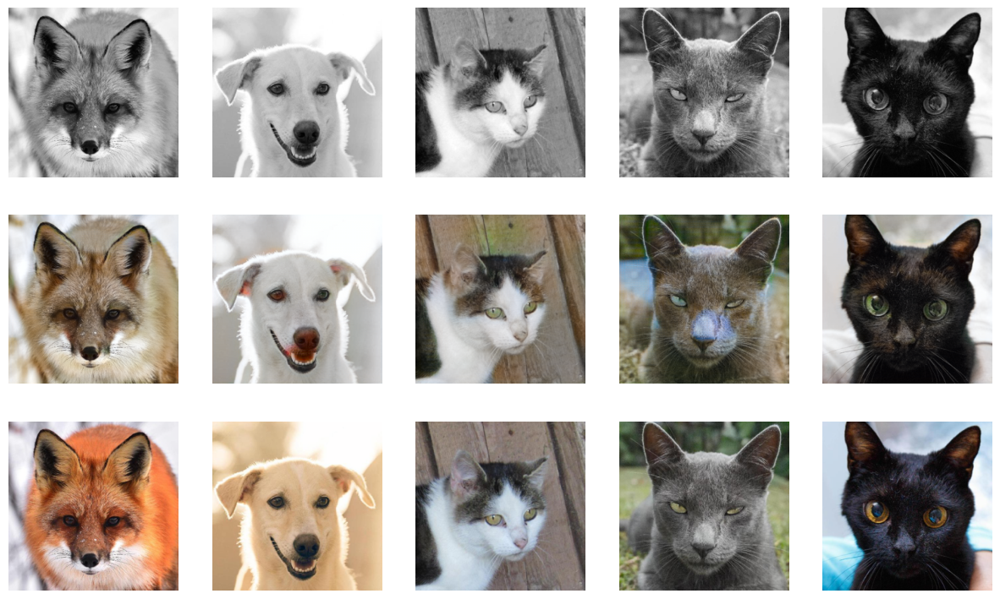

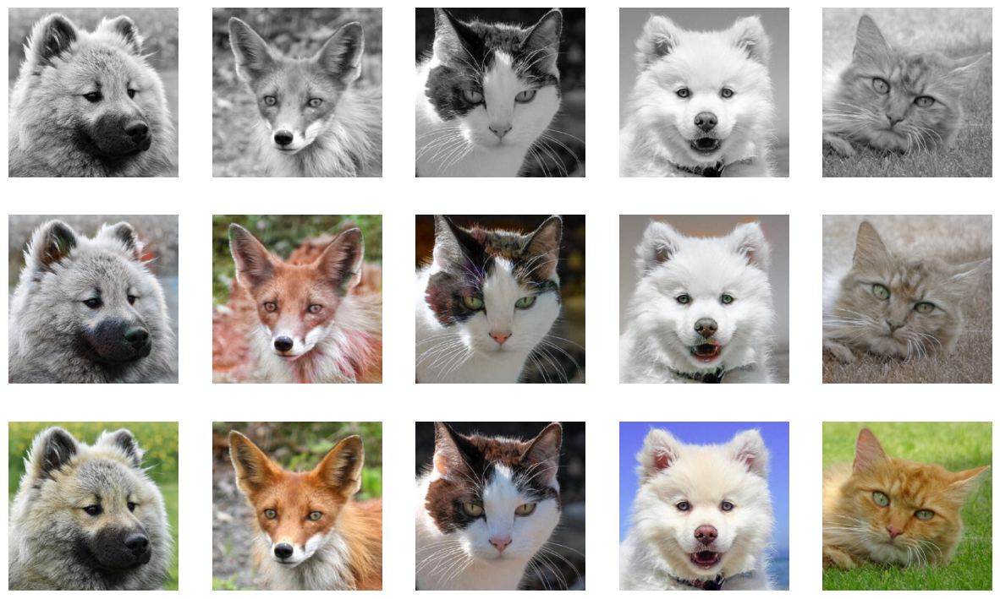

/tmp/ipykernel_34/1976637245.py:34: UserWarning: Conversion from CIE-LAB, via XYZ to sRGB color space resulted in 2 negative Z values that have been clipped to zero
  image_rgb = color.lab2rgb(image)


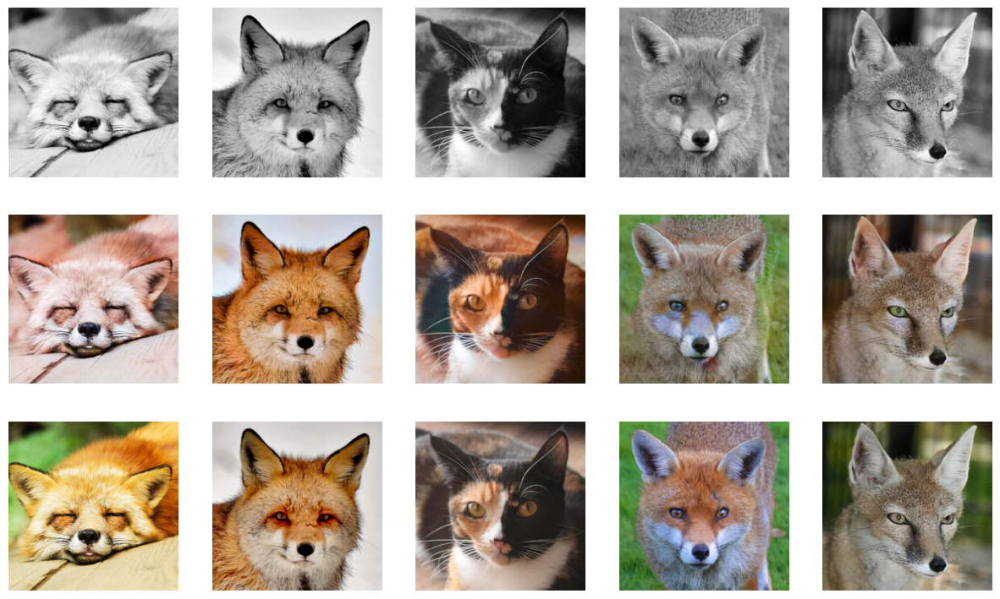

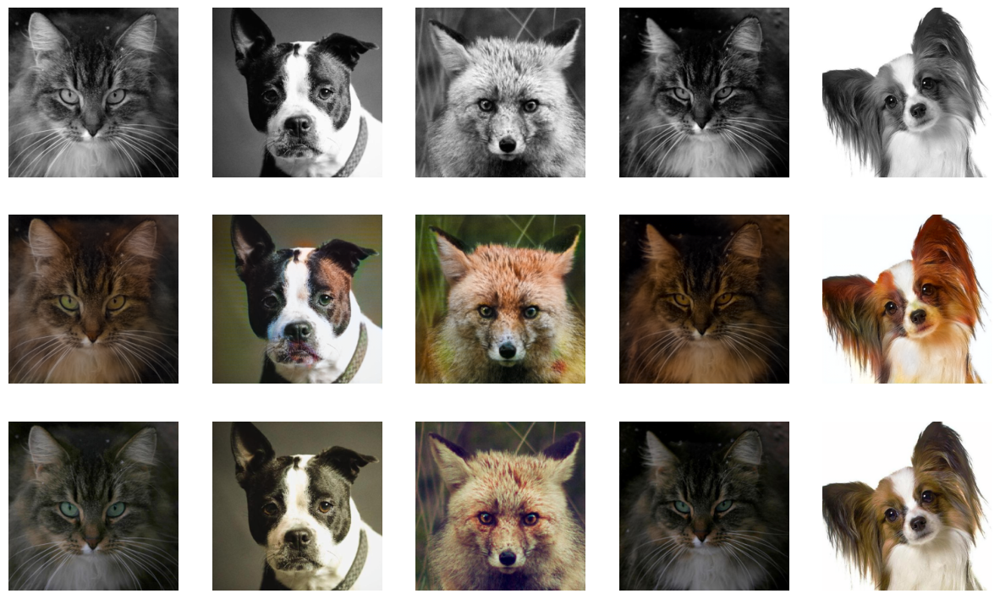

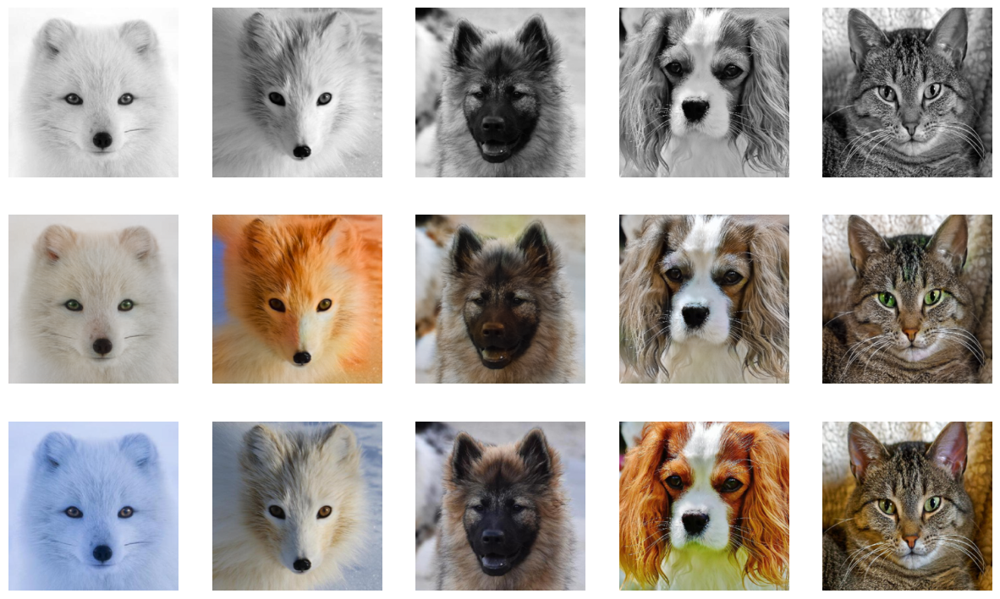

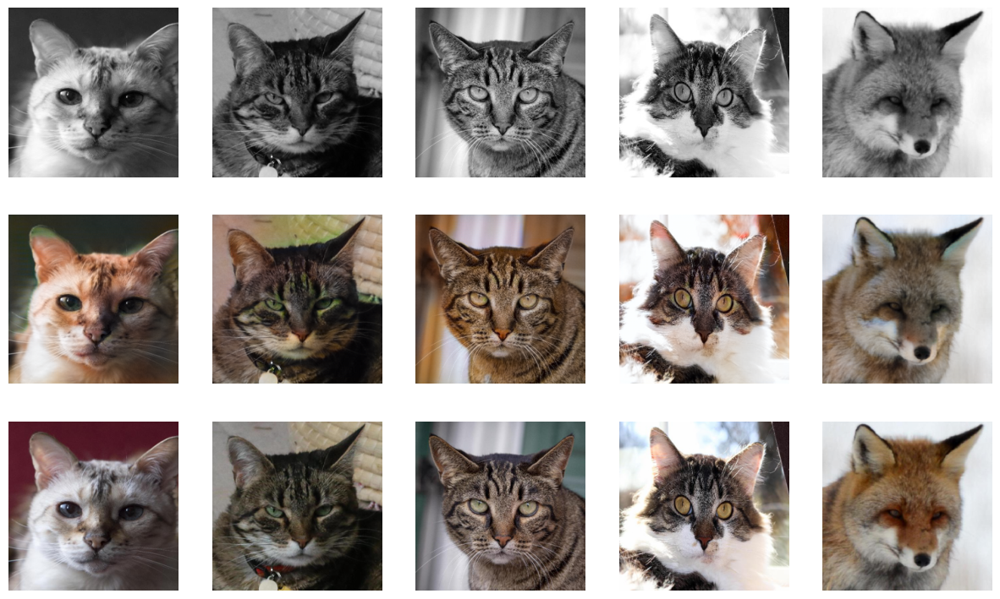

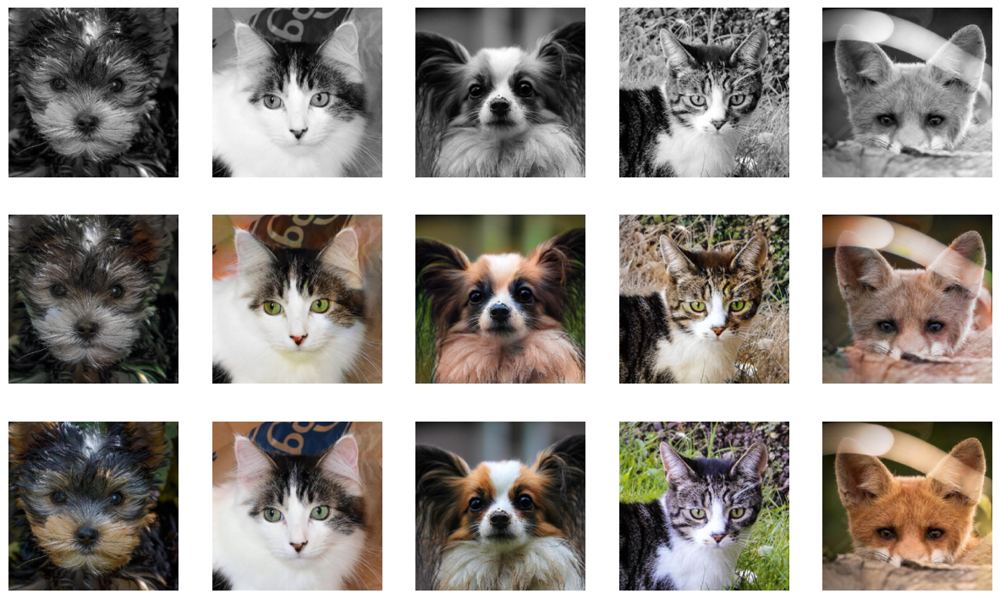

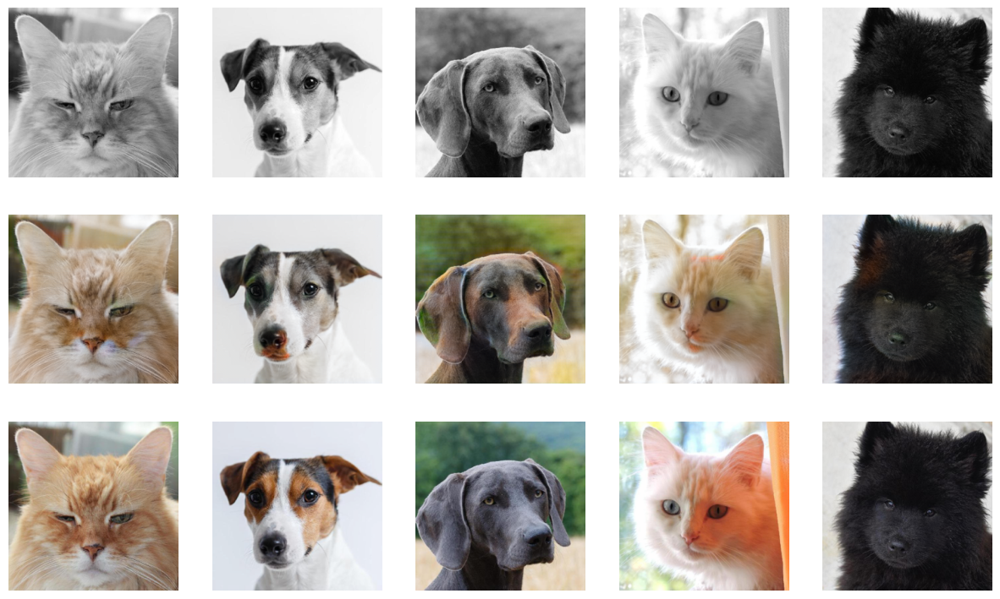

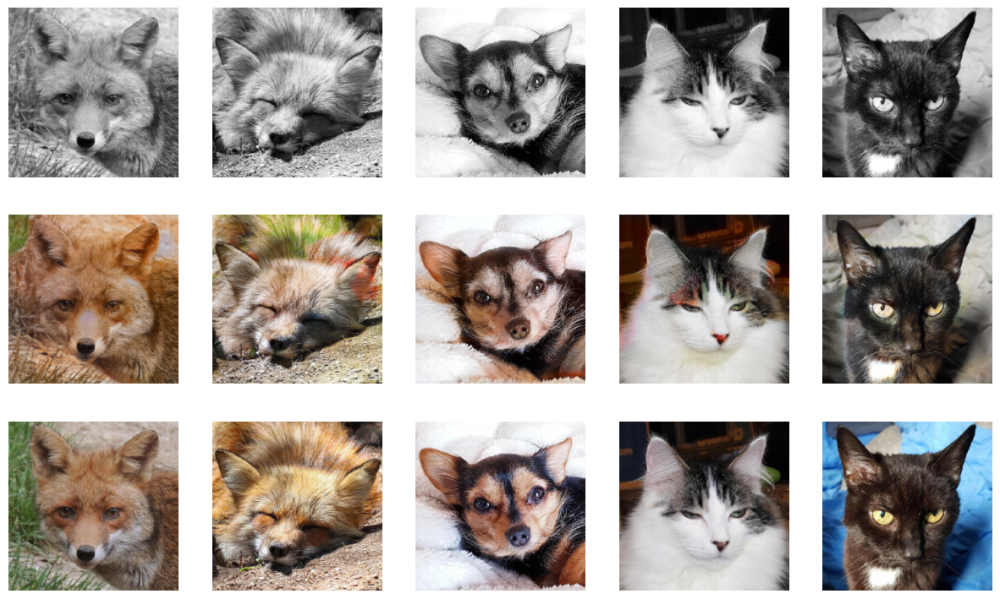

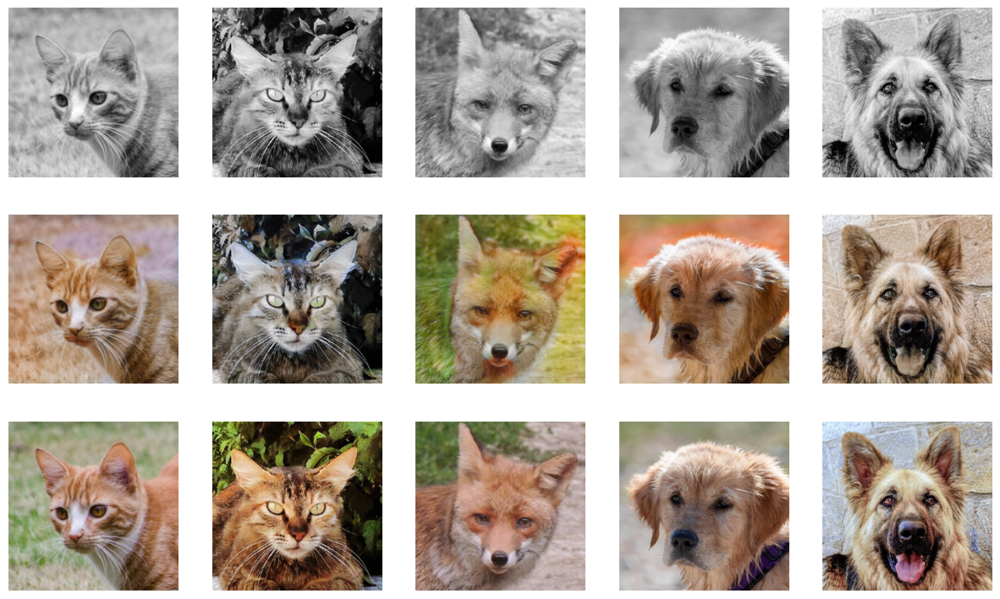

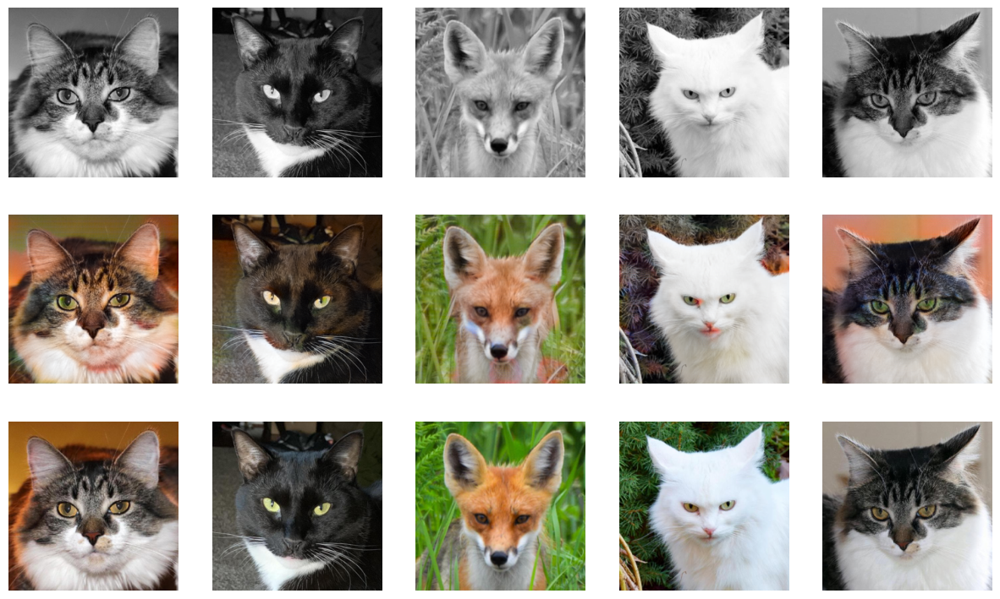

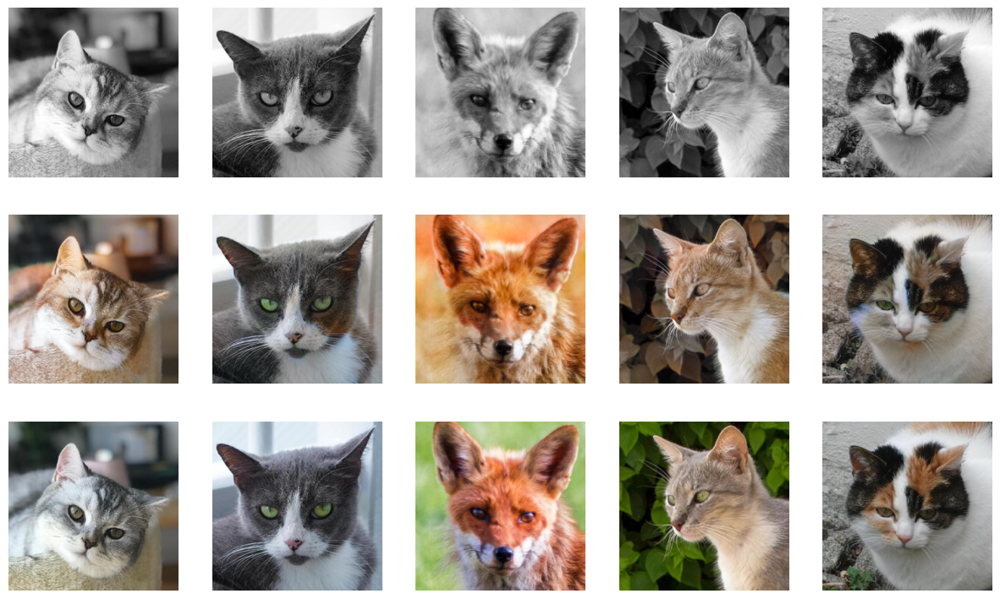

In [ ]:
model.eval()
for data in val_loader:
    visualize_work_model(model, data)

# Инференс модели

In [36]:
model = Model(device).to(device)

In [37]:
model.load_state_dict(torch.load('weights/model_weights.pth')) # нужна видеокарта для инференса

<All keys matched successfully>

In [78]:
def single_lab_to_rgb_image(L, fake_ab):
    L = (L + 1.) * 50.
    fake_ab = fake_ab * 110.
    image = torch.cat([L, fake_ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    image_rgb = color.lab2rgb(image)
    return image_rgb.squeeze(0)

def inference_image(model, path_to_image:str, save_image=False):
    plt.figure(figsize=(13, 7))
    image = Image.open(path_to_image).convert("RGB")
    transform_resize = transforms.Resize((256, 256))
    image_transformed = transform_resize(image)
    image_numpy = np.array(image_transformed)
    image_lab = color.rgb2lab(image_numpy).astype("float32")
    image_tensor = transforms.ToTensor()(image_lab).to(device)
    L = image_tensor[[0], ...] / 50. - 1.

    model.generator_net.eval()
    with torch.no_grad():
        model.L = L.unsqueeze(0)
        model.forward()

    model.generator_net.train()
    fake_ab = model.fake_ab.detach()
    color_image_predicted = single_lab_to_rgb_image(model.L, fake_ab)

    plt.subplot(1, 2, 1); plt.imshow(image.convert("L"), cmap="gray"); plt.axis("off"); plt.title("Черно-белое изображение")
    plt.subplot(1, 2, 2); plt.imshow(color_image_predicted); plt.axis("off"); plt.title("Предсказанное изображение")

    if save_image:
        plt.savefig(color_image_predicted)

    plt.show()

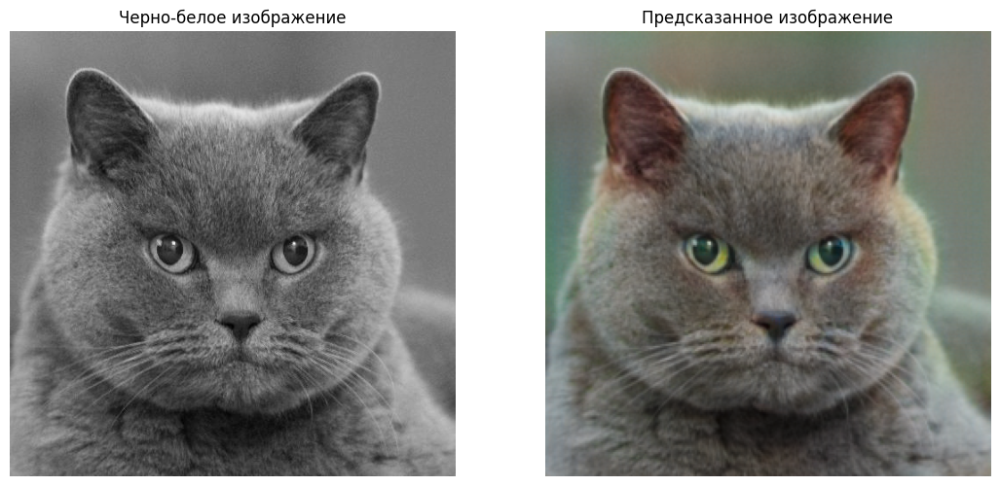

In [67]:
path_to_bw_image = "/content/pixabay_cat_004826.jpg"
inference_image(model, inference_image)